# All Talks
https://www.youtube.com/channel/UCsX05-2sVSH7Nx3zuk3NYuQ/videos?flow=grid&sort=p&view=0

# All Posters
https://www.flickr.com/photos/129877449@N07/sets/72157693710700302/

# Note
These are my very condensed notes. The full notes can be found here. 

https://github.com/rawrgulmuffins/essays/tree/master/conference_notes/pycon_2018


# Installation Notes For Apache Arrow
* Download java 8_172
* Brew install scala
* brew install apache-spark
* pip install pyspark
* pip isntall pyarrow
* [Arrow Tutorial](http://arrow.apache.org/docs/python/memory.html)

# Apache Arrow

TODO: Convert the next slide into just PySpark

```
In [1]: from pyspark.sql.functions import rand
   ...: df = spark.range(1 << 22).toDF("id").withColumn("x", rand())
   ...: df.printSchema()
   ...: 
root
 |-- id: long (nullable = false)
 |-- x: double (nullable = false)


In [2]: %time pdf = df.toPandas()
CPU times: user 17.4 s, sys: 792 ms, total: 18.1 s
Wall time: 20.7 s

In [3]: spark.conf.set("spark.sql.execution.arrow.enabled", "true")

In [4]: %time pdf = df.toPandas()
CPU times: user 40 ms, sys: 32 ms, total: 72 ms                                 
Wall time: 737 ms

In [5]: pdf.describe()
Out[5]: 
                 id             x
count  4.194304e+06  4.194304e+06
mean   2.097152e+06  4.998996e-01
std    1.210791e+06  2.887247e-01
min    0.000000e+00  8.291929e-07
25%    1.048576e+06  2.498116e-01
50%    2.097152e+06  4.999210e-01
75%    3.145727e+06  7.498380e-01
max    4.194303e+06  9.999996e-01
```

[Source for last slide](https://arrow.apache.org/blog/2017/07/26/spark-arrow/)

# Property Based Testing
https://youtu.be/MYucYon2-lk

In [ ]:
from hypothesis import given
from hypothesis.strategies import integers

@given(integers())
def test_adds_zero (a):
    assert add(a, 0) == a

test_adds_zero()

In [ ]:
!py.test test_add.py

In [ ]:
!py.test --hypothesis-show-statistics test_add.py

In [ ]:
@given(integers(), integers())
def test_commutative(a, b):
    assert add(a, b) == add(b, a)

In [ ]:
!py.test test_commutative.py

In [ ]:
def add(a: int, b: int) -> int:
    if '2' in str(b):
        return 3
    return a

# git-annex
* Example repo here  https://github.com/djarecka/full_dataset
* Talk Start: https://youtu.be/VJ0vibC_Hl0?t=1338
* Example Usage: https://youtu.be/VJ0vibC_Hl0?t=1486

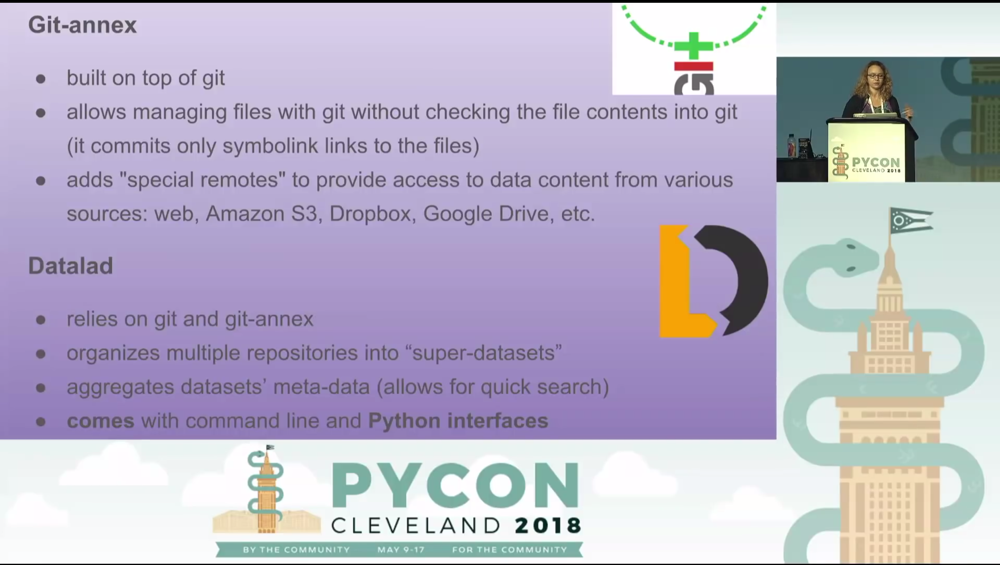

In [ ]:
from datalad.api import install
ds = install('https://github.com/djarecka/datalad_repo_test')

In [ ]:
!tree -L 4 datalad_repo_test/ds000114-nipype_tutorial_output

In [ ]:
!ls datalad_repo_test/ds000114-nipype_tutorial_output/2ndlevel/spm_con_0001_fwhm4

In [ ]:
ds.get("ds000114-nipype_tutorial_output/2ndlevel/spm_con_0001_fwhm4/spmt_0001_thr.nii")

In [ ]:
!ls -Llh datalad_repo_test/ds000114-nipype_tutorial_output/2ndlevel/spm_con_0001_fwhm4

# Interesting Community Data

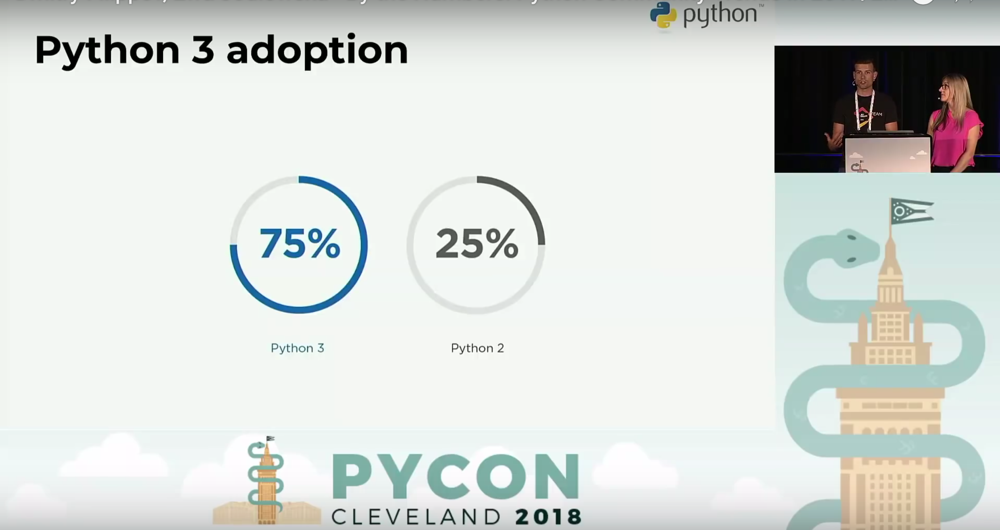

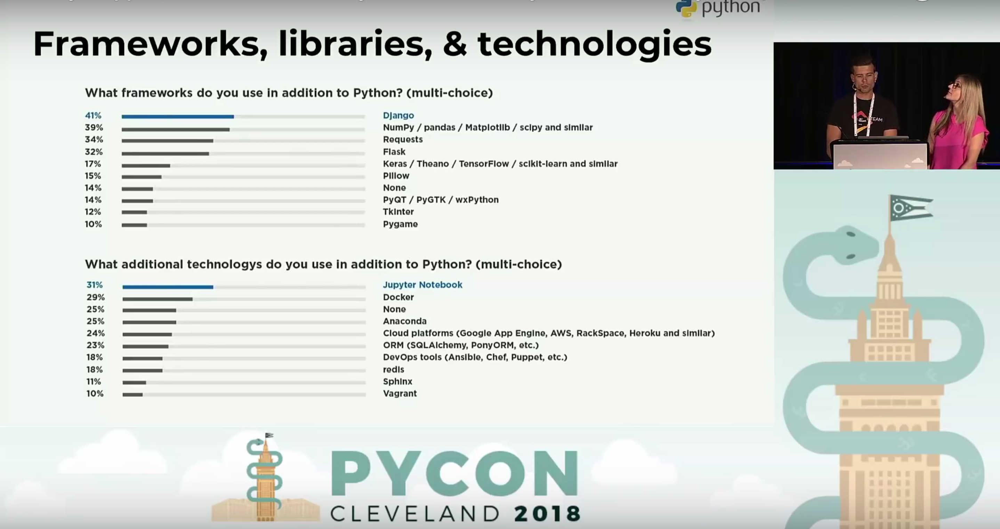

# The Case For AsyncIO
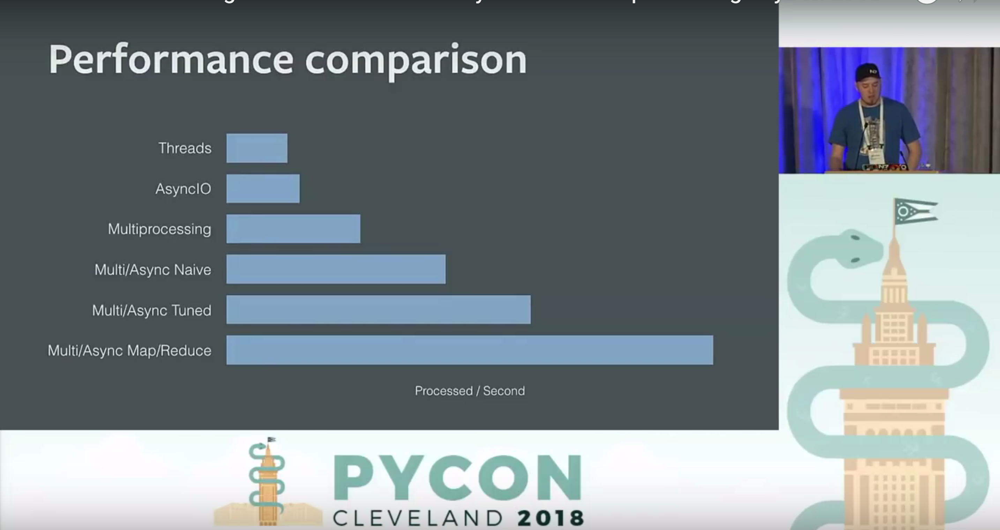

# Pipenv and Pipfile
The following section wont run in Jupyter

In [ ]:
pip install pipenv
mkdir test_dir
cd test_dir
pipenv install
pipenv install flask
pipenv install --dev pytest
pipenv lock

In [ ]:
pipenv shell

In [ ]:
pipenv run python test_dir.py

# Some Python Typing Tips

In [ ]:
from typing iport Optioanl

def get_foo(foo_id: Optional[int]) -> Optional[Foo]:
    if foo_id is None:
        return None
    return Foo(foo_id)

my_foo = get_foo(3)
my_foo.id           # Error: NoneType has no attribute 'id'

In [ ]:
from typing import Optional, overload

@overload
def get_foo(foo_id: None) -> None:
    pass

@overload
def get_foo(foo_id: int) -> Foo:
    pass

def get_foo(foo_id: Optional[int]) -> Optional[Foo]:
    if foo_id is None:
        return None
    return Foo(foo_id)

reveal_type(get_foo(None)) # None
reveal_type(get_foo(1))    # Foo

In [ ]:
from typing_extensions import Protocol # Have to import this since it's experimental

Class Renderable(Protocol):
    def render(self) -> str: ...
        
def render(obj: Renderable) -> str:
    return obj.render()

class Foo:
    def Render(self) -> str:
        return "Foo!"
    
render(Foo()) # Clean!
render(3) # Error: expected Renderable

# Escape Hatches

In [ ]:
from typing import cast, any

my_config = get_config_var('my_config')
reveal_type(my_config) # Any

my_config = cast(
    Dict[str, int],
    get_config_var('my_config'),)

reveal_type(my_config) # Dict[str, int]

In [ ]:
from typing import TypeVar

AnyStr = TypeVar('AnyStr', str, bytes)

def concat(a: AnyStr, b: AnyStr) -> AnyStr:
    return a + b

concat('foo', b'bar') # Typecheck error!
concat(3, 6)          # Typecheck error!
reveal_type(concat('foo', 'bar')) # str
reveal_type(concat(b'foo', b'bar')) # bytes

In [ ]:
triggers_a_mypy_bug('foo') # type: ignore

# Post Mortem Suggestions
[What does a Post Mortem Look like?](https://youtu.be/L9Y2ap6vIMg?t=511)

[Where Can I read more?](https://how.complexsystems.fail)

[Interesting poster on using Docker layers to make reproducible environments for machine learning models](https://www.flickr.com/photos/129877449@N07/42128542031/in/album-72157693710700302/)

# Logging Tips
* Using the `logging.handlers.MemoryHandler` lets you buffer logging output.
* You can use this to reduce noise except if there are errors.
* This lets you turn INFO logs of in production but still see them for errors.

In [ ]:
class SmartBufferHandler(logging.handlers.MemoryHandler):
    # Missing init to fit on slides
    def emit(self, record):
        # The buffer is not thread safe by default
        if len(self.buffer) == self.capacity - 1:
            self.buffer.pop(0)
            super().emit(record)

handler = SmartBufferHandler(
    buffer=2,
    target=logging.StreamHandler(),
    flushLevel=ERROR)
logger = logging.getLogger(__name__)

# Generator Comprehensions

In [ ]:
test = [item for item in range(10)]

In [ ]:
test = (item for item in range(10))

# This Example Finally Made Me understand functools.partial

In [ ]:
from functools import partial
basetwo = partial(int, base=2)
basetwo('10010')

# Python Profiling

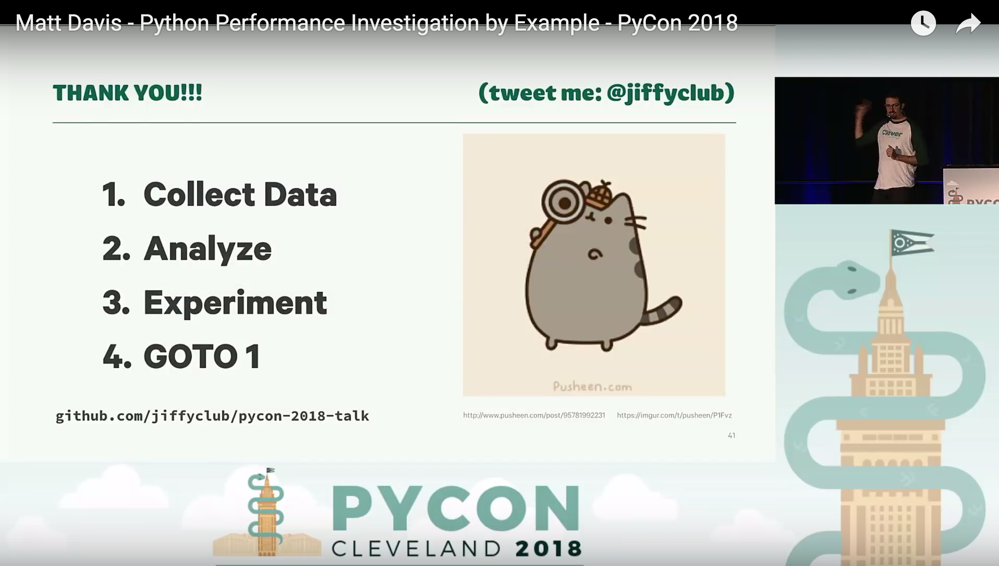

# List of known profilers
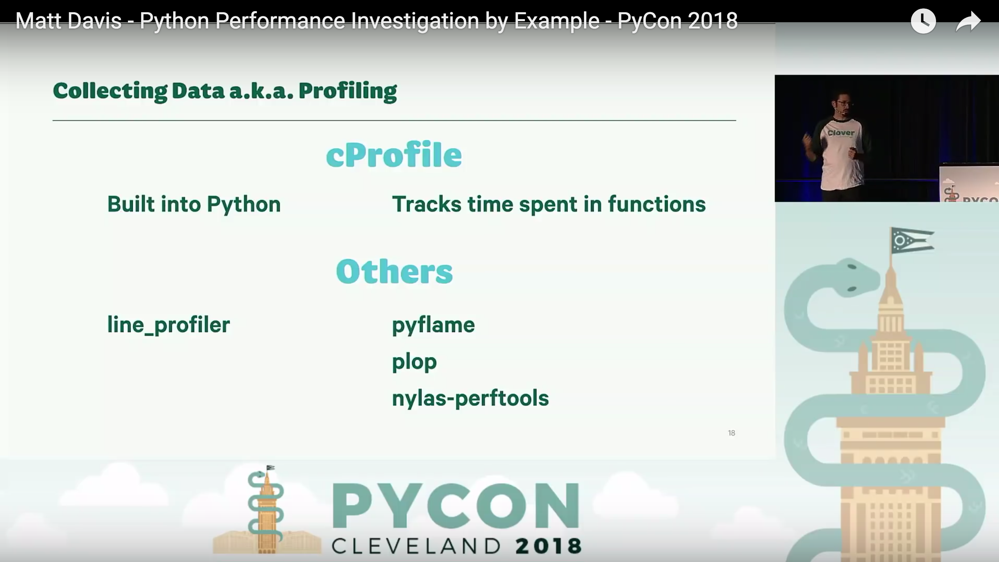

In [ ]:
import glob
%prun -D program.prof glob.glob('*.txt')

In [ ]:
%load_ext snakeviz

In [ ]:
% snakeviz glob.glob('*.txt')

# Dask

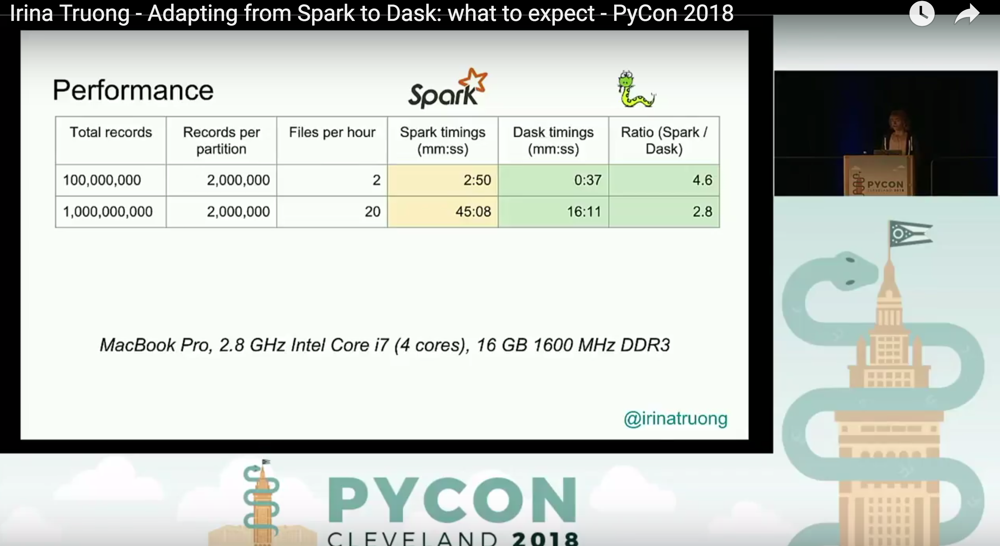

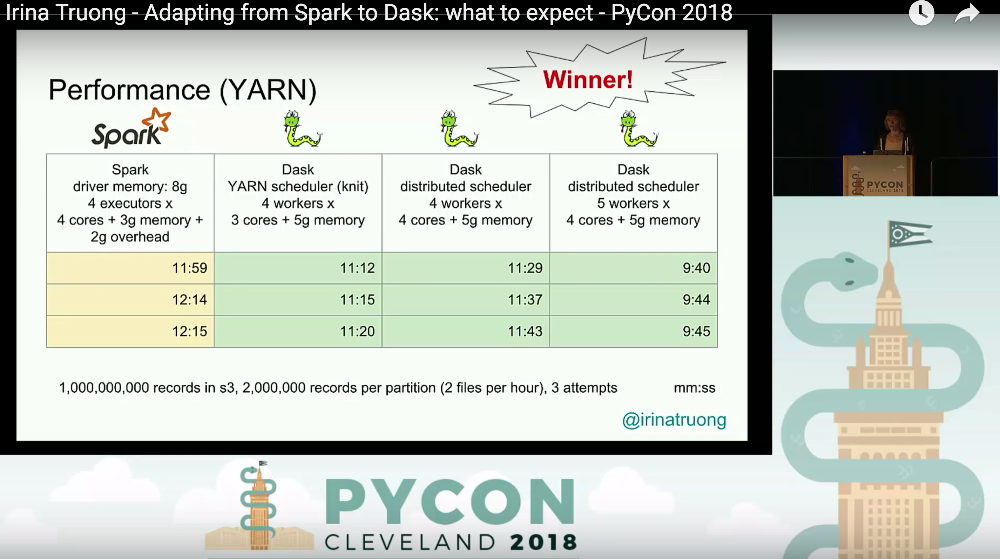

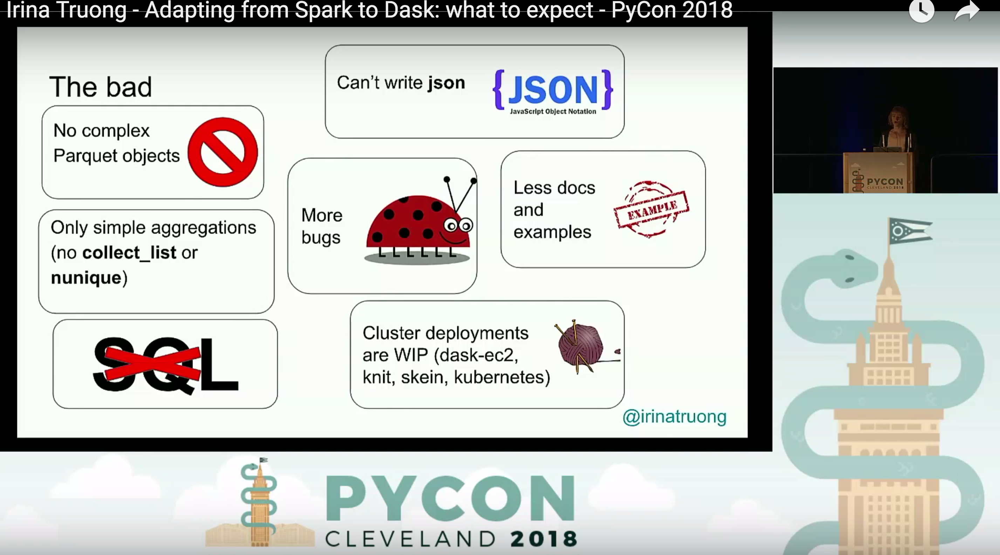